# **Scomposizione strumenti**

## di Edoardo Oldani S4675431
## collaboratore: Gabriele Lanteri S4638890

## Questo notebook è stato realizzato con l'idea di analizzare una canzone e riuscire a scomporla in più parti. La scomposizione eseguita divide quindi la traccia iniziale in parte armonica e percussiva. 


## **Prima parte**, Inizializzazione progetto:
### Il progetto inizia importando librerie e caricando all'interno del notebook la traccia audio.

### Iniziamo importando le librerie standard python e per il progetto utilizzeremo Librosa

In [130]:
from __future__ import print_function
import numpy as np
import matplotlib.pyplot as plt
import IPython
import warnings

warnings.filterwarnings("ignore")
%matplotlib inline

import librosa
import librosa.display

### Selezioniamo la canzone ed impostiamo la durata che vogliamo salvare e la carichiamo

In [131]:
#Choose the song to execute and the duration (in sec)
song = 'drive/MyDrive/Colab_Notebooks/UploadColab/smellsliketeenspirits.mp3'

Il metodo load carica un file audio come una serie temporale a floating point 
(y) che verrà ricampionato automaticamente alla frequenza indicata (sr, 
default=22050)

In [132]:
duration = 60

y, sr = librosa.load(song, duration=duration)

## **Seconda parte**, analisi della traccia:
### Mostro la traccia caricata e dopodiché eseguo una trasformazione di fourier discreta e ne catturo lo spettrogramma.

### Riproduco e plotto il grafico

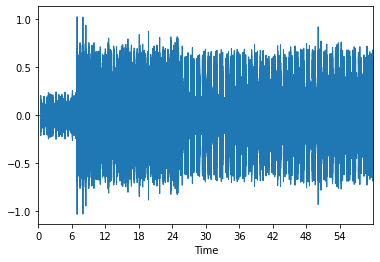

In [133]:
#Plotto la traccia audio e la riproduco
librosa.display.waveplot(y)

IPython.display.Audio(data=y, rate=sr)

### Ne eseguo la trasformata di Fourier discreta e dopodiché convertiamo lo spettrogramma in uno deciBell-scaled e lo mostriamo
 La "stft" è la short time Fourier transform: consiste nella trasformata di Fourier ma divide un segnale a lunga durata e lo divide in segmenti della stessa lunghezza, dopodiché ne esegue per ognuno la trasformata di Fourier.

Siccome il range di pressione sonora percepibile è molto più ampio rispetto alla percezione umana approssimiamo la scala di valori utilizzando "amplitude_to_db" che converte il segnale in una scala logaritmica. Il risultato quindi è un plot in cui riusciamo a vedere corrispondenze con quello che sentiamo.

In [134]:
y_ft = librosa.stft(y)

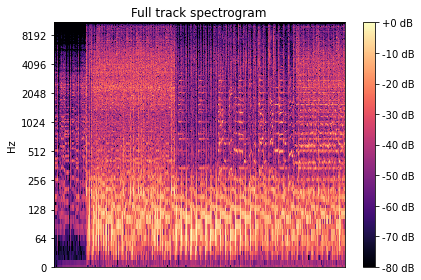

In [135]:
plt.figure()

dbScaled = librosa.amplitude_to_db(np.abs(y_ft), ref=np.max)

librosa.display.specshow(dbScaled, y_axis='log')

plt.colorbar(format= '%+2.0f dB')
plt.title('Full track spectrogram')

plt.tight_layout()

##**Terza** parte, creazione maschere:
###In questa parte andiamo a ricavare la parte armonica e percussiva calcolando delle maschere e applicandole al segnale.

###Ricaviamo le due maschere
Per trovare le due maschere andremo ad utilizzare il metodo che utilizza la funzione chiamata in precedenza per trovare le due parti in modo rapido: librosa.decompose.hpss.
Siccome il metodo in precedenza chiamava in pipeline tre metodi esterni noi andremo a passare alla decompose il risultato della stft.
Il parametro "margin" permette di isolare al meglio le singole parti, se il valore è una tupla allora andiamo ad esaltare con valori diversi le due parti (harm,perc)

In [136]:
mask_harm, mask_perc = librosa.decompose.hpss(y_ft, mask=True, margin=(5.0, 3.0))

###Mostriamo le due maschere

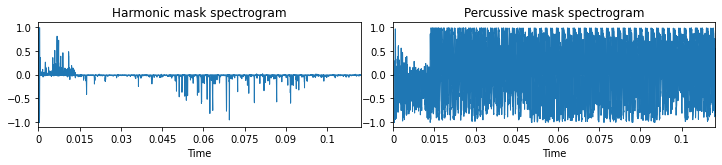

In [137]:
plt.figure(figsize=(10,4))

plt.subplot(2, 2, 1)
librosa.display.waveplot(mask_harm)
plt.title('Harmonic mask spectrogram')

plt.subplot(2, 2, 2)

librosa.display.waveplot(mask_perc)
plt.title('Percussive mask spectrogram')

plt.tight_layout()

###Stabiliamo i giusti valori per isolare meglio le componenti
Rendiamo positivi tutti i valori del segnale dopo la trasformata di Fourier e troviamo la potenza giusta, che quindi isoli bene le due parti limitando il più possibili errori o "buchi", ricavando il segnale intero. Infine calcoliamo la phase che è il valore....

In [138]:
power=1.5
S_full = np.abs(y_ft)
S_full **= power
phase = np.exp(1.0j * np.angle(y_ft))

###Calcoliamo la parte armonica e percussiva
Adesso andiamo ad applicare la maschera al segnale iniziale e moltiplichiamo anche per la phase. Dopo questi calcoli ci basta effettuare la trasformata di Fourier inversa per ottenere i due segnali divisi.

In [139]:
harm_masked = mask_harm * S_full * phase
perc_masked = mask_perc * S_full * phase

y_harmonic = librosa.istft(harm_masked)
y_percussive = librosa.istft(perc_masked)

###Mostriamo il segnale e ascoltiamo le tracce

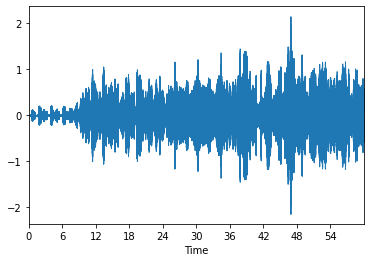

In [140]:
librosa.display.waveplot(y_harmonic)
IPython.display.Audio(data=y_harmonic, rate=sr)

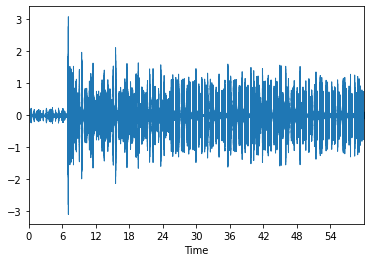

In [141]:
librosa.display.waveplot(y_percussive)
IPython.display.Audio(data=y_percussive, rate=sr)

###Ricaviamo le tracce date le maschere


## **Quarta** parte, spettrogrammi a confronto:
### In questa parte andremo a mostrare ed analizzare gli spettrogrammi relativi a parte armonica, percussiva e traccia intera.

### Decompongo lo spettrogramma
Questa volta non andiamo a creare delle maschere da applicare poi al segnale ma andremo a ritornare gli spettrogrammi relativi a parte armonica e percussiva.
Assegnando al "margin" un valore maggiore di 1.0 andremo anche a ricavare il residuo, quindi i valori che non appartengono a nessuna delle due parti, utilizziamo il valore impostato al momento della creazione delle maschere. 

In [142]:
Harm, Perc= librosa.decompose.hpss(y_ft, margin=(5.0, 3.0))

Res = y_ft - (Harm + Perc)

### Riprendo lo spettrogramma full track

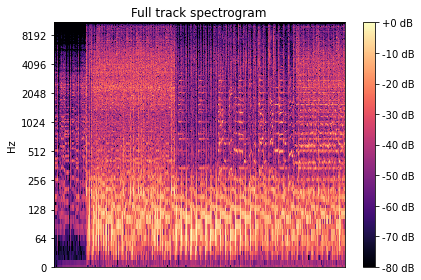

In [143]:
plt.figure()

librosa.display.specshow(dbScaled, y_axis='log')

plt.colorbar(format= '%+2.0f dB')
plt.title('Full track spectrogram')

plt.tight_layout()

### Adesso mostro gli spettrogrammi (sempre dopo la conversione in dB scaled) delle due parti + il residuo
Come si può notare i valori del residuo sono alti, questo perché essendo una canzone complessa, con molti strumenti, è difficile isolare solo la parte armonica e percussiva

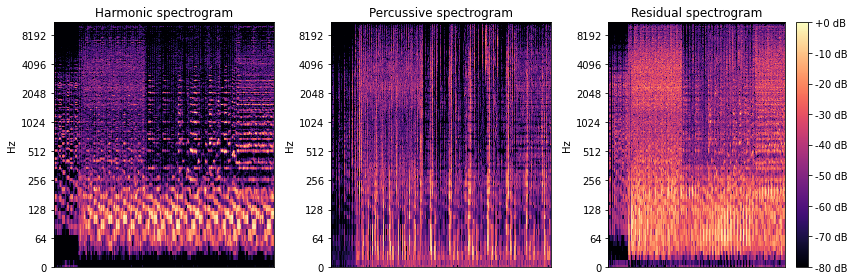

In [144]:
plt.figure(figsize=(12,4))
plt.subplot(1, 3, 1)

librosa.display.specshow(librosa.amplitude_to_db(np.abs(Harm),ref=np.max), y_axis='log')

plt.title('Harmonic spectrogram')

plt.subplot(1, 3, 2)
librosa.display.specshow(librosa.amplitude_to_db(np.abs(Perc), ref=np.max), y_axis='log')

plt.title('Percussive spectrogram')

plt.subplot(1, 3, 3)
librosa.display.specshow(librosa.amplitude_to_db(np.abs(Res), ref=np.max), y_axis='log')
plt.title('Residual spectrogram')
plt.colorbar(format='%+2.0f dB')
plt.tight_layout()

## **Quinta parte**, separazione della parte strumentale:
### Adesso separiamo la parte strumentale da quella vocale.

###Filtriamo il segnale rimuovendo il rumore
Utilizziamo la nn_filter per pulire il segnale, la metrica è del coseno quindi applichiamo la similarità del coseno e separiamo i frame simili di almeno 2 secondi in modo tale da non essere ingannati dalla continuità locale.

In seguito utilizziamo una specie di asserzione per mostrare come il segnale filtrato è minore del segnale intero (non filtrato)

In [145]:
S_filter = librosa.decompose.nn_filter(S_full,
                                       aggregate=np.median,
                                       metric='cosine',
                                       width=int(librosa.time_to_frames(2, sr=sr)))

S_filter= np.minimum(S_full, S_filter)

### Creiamo la maschera per la parte strumentale
Per creare la maschera questa volta utilizziamo il metodo softmask, utilizzato internamente anche da decompose.hpss. Come parametro per la maschera abbiamo bisogno di una potenza e di un margine, utilizzato per filtrare valori troppo bassi che quindi risulterebbero solo rumore

In [155]:
margin_i = 2
power = 2

mask_i = librosa.util.softmask(S_filter, margin_i * (S_full - S_filter), power=power)

###Ricaviamo il risultato della separazione
Applichiamo la maschera al segnale filtrato e ne effettuiamo la trasformata di Fourier inversa per ottenere la traccia audio filtrata della parte vocale

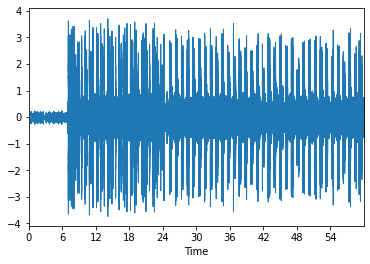

In [158]:
S_background = mask_i * S_filter
back_y = librosa.istft(S_background*phase)

librosa.display.waveplot(back_y)

IPython.display.Audio(data=back_y, rate=sr)

## **Sesta** parte, ultima divisione del suono:
###Nell'ultima parte del notebook, andremo a dividere in componente armonica e percussiva la traccia senza la parte vocale.

### Scomponiamo la traccia in parte armonica e percussiva
Per non ripetere le stesse operazioni questa volta utilizzeremo un metodo della libreria librosa che esegue in pipeline le operazioni effettuate in precedenza, quindi:

stft -> decompose.hpss -> istft

Otteniamo quindi le due parti già divise

In [148]:
back_harmonic, back_percussive = librosa.effects.hpss(back_y)

### Eseguo e plotto la parte armonica

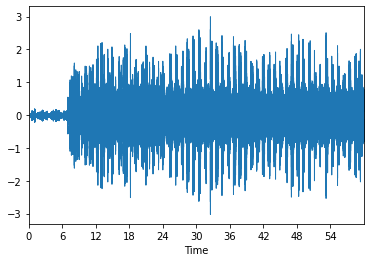

In [149]:
librosa.display.waveplot(back_harmonic)

IPython.display.Audio(data=back_harmonic, rate=sr)

### Eseguo e plotto la parte percussiva

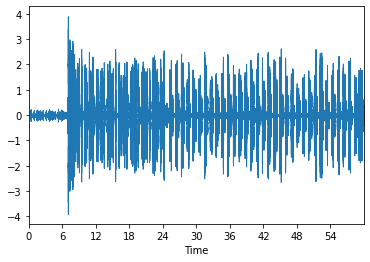

In [150]:
librosa.display.waveplot(back_percussive)

IPython.display.Audio(data=back_percussive, rate=sr)

# Risultati

## In questo notebook abbiamo visto la scomposizione della traccia audio in parte armonica e percussiva tramite applicazione di maschere al segnale.